In [127]:
import torch
from torchvision import transforms
from transformers import DistilBertTokenizer
import numpy as np

import sys
sys.path.append('../')

from factory import MAECLIPFactory
from misc.transforms import get_original_vit_image_encoder_transforms

In [128]:
tokenizer = DistilBertTokenizer.from_pretrained("distilbert-base-uncased")

In [129]:
class CFG:

    text_encoder_name = "distilbert-base-uncased"
    text_encoder_pretrained = True
    text_encoder_trainable = False

    temperature = 1.0

    image_size = 224
    patch_size = 14
    image_embedding = 512
    text_embedding = 768
    projection_dim = 256
    dropout = 0.1

    mask_ratio = 0.75
    alpha = 0
device = torch.device('cuda')

In [130]:
model_path = '/home/ykojima/Desktop/clip/mae_clip/20240119_mae_clip_joint_scratch_training_alpha=1_2/checkpoint_55.pth'

In [131]:
cfg = CFG()

factory = MAECLIPFactory(cfg)
model = factory.create().to("cuda")
status = torch.load(model_path, map_location="cuda")

model.load_state_dict(status['model'])
model = model.mae
model.eval()

MAE_ViT(
  (_shuffler): PatchShuffle()
  (encoder): MAE_Encoder(
    (patchify): Conv2d(3, 512, kernel_size=(14, 14), stride=(14, 14))
    (transformer): Sequential(
      (0): Block(
        (norm1): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
        (attn): Attention(
          (qkv): Linear(in_features=512, out_features=1536, bias=False)
          (q_norm): Identity()
          (k_norm): Identity()
          (attn_drop): Dropout(p=0.0, inplace=False)
          (proj): Linear(in_features=512, out_features=512, bias=True)
          (proj_drop): Dropout(p=0.0, inplace=False)
        )
        (ls1): Identity()
        (drop_path1): Identity()
        (norm2): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
        (mlp): Mlp(
          (fc1): Linear(in_features=512, out_features=2048, bias=True)
          (act): GELU(approximate='none')
          (drop1): Dropout(p=0.0, inplace=False)
          (norm): Identity()
          (fc2): Linear(in_features=2048, out_features=5

In [132]:
from data.dataloader_builder import CLIPDataLoaderBuilder
dataloader_builder = CLIPDataLoaderBuilder(tokenizer, batch_size=1, num_workers=1)
data_loader = dataloader_builder("/home/ykojima/Desktop/clip/mae_clip/dataset/coco", "/home/ykojima/dataset/coco/annotations/captions_val2014.json", 'val', test=True)

In [133]:
# transforms = get_original_vit_image_encoder_transforms('valid')
# print(transforms)
inverse = transforms.Compose([ transforms.Normalize(mean = [ 0., 0., 0. ],
                                                     std = [ 1/0.229, 1/0.224, 1/0.225 ]),
                                transforms.Normalize(mean = [-0.4850, -0.4560, -0.4060],
                                                     std = [ 1., 1., 1. ]),
                                transforms.ToPILImage() # transform tensor to pillow for simple visualization
                               ])

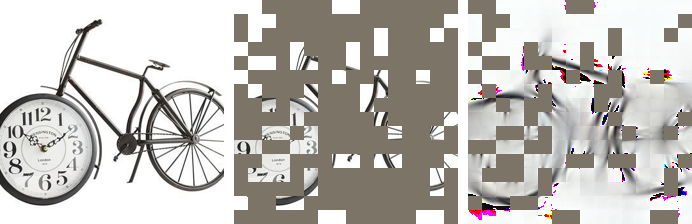

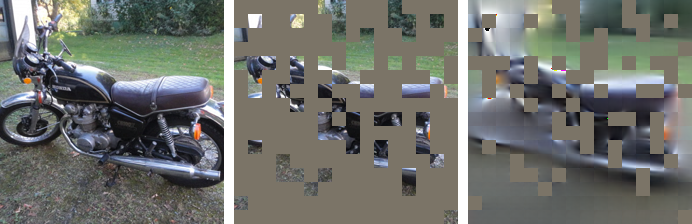

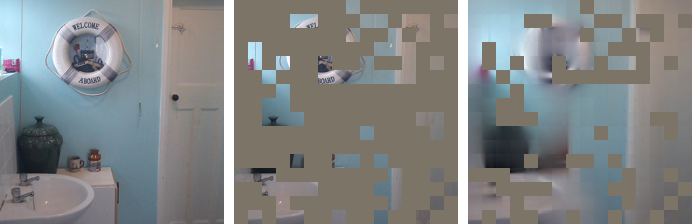

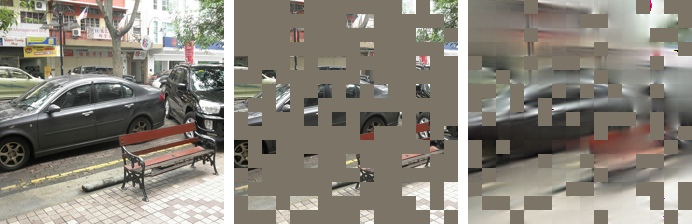

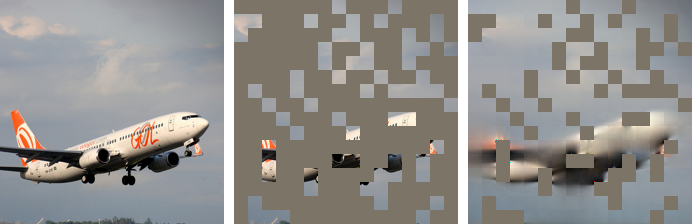

...

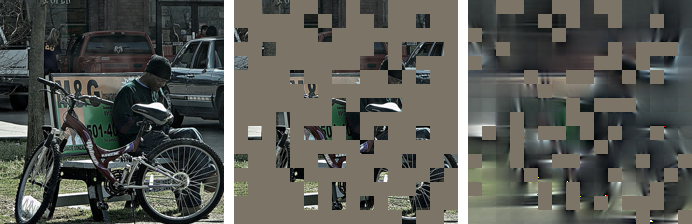

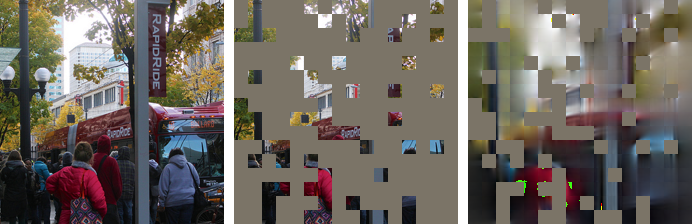

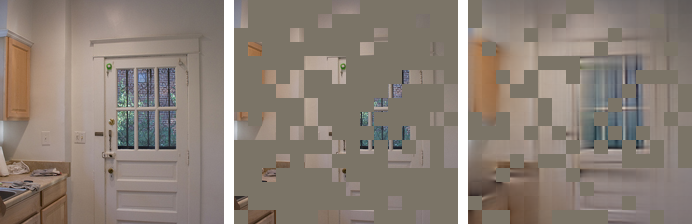

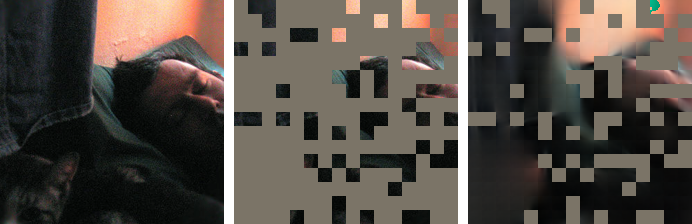

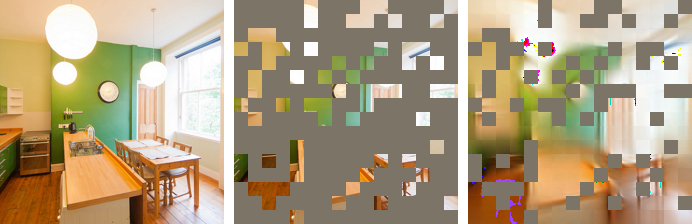

In [134]:
from PIL import Image

def concat_h(img1, img2, img3, color="white", spacer=10):
    dst = Image.new(
        "RGB", (img1.width + spacer + img2.width + spacer + img3.width, max(img1.height, img2.height, img3.height)), color
    )
    dst.paste(img1, (0, 0))
    dst.paste(img2, (img1.width + spacer, 0))
    dst.paste(img3, (img1.width + spacer + img2.width + spacer, 0))

    return dst

for batch in data_loader:
    predicted_img, mask = model(batch['image'].to(device))

    # tensor, (3, 224, 224)
    input = batch['image'][0]
    predicted_img = predicted_img.cpu()[0]
    mask = mask.cpu()[0]

    masked_input = input * (1 - mask)
    masked_predicted_img = predicted_img * mask
    
    input = inverse(input)
    masked_input = inverse(masked_input)
    masked_predicted_img = inverse(masked_predicted_img)

    display(concat_h(input, masked_input, masked_predicted_img))